In [1]:
import glob
import cv2
import os

import numpy as np
from matplotlib import pyplot as plt

from statistics import mean 
from itertools import permutations, combinations

import skimage
import imagehash
from PIL import Image
from scipy.spatial import distance as dist
from scipy.spatial.distance import pdist, squareform
from skimage.metrics import structural_similarity as ssim

In [2]:
def display_frames(frame_list):
    
    fig = plt.figure(figsize = (80, 80))
    rows = round(len(frame_list)/9)
    columns = round(len(frame_list)/9)
    
    for i in range(1,len(frame_list)+1):
        fig.add_subplot(rows, columns,i)
        plt.imshow(frame_list[i-1])

In [3]:
frames_path = "../datasets/vedio_frames"

In [4]:
def get_image_hist_dictionary(Frame_Path):
    image_index = {}
    image_hist = {}
    
    for imagePath in glob.glob(Frame_Path + "/*.jpg"):
        filename = imagePath[imagePath.rfind("/") + 1:]
        image = cv2.imread(imagePath)
        image_index[filename] = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
        hist = cv2.calcHist([image], [0, 1, 2], None, [8, 8, 8],[0, 256, 0, 256, 0, 256])
        hist = cv2.normalize(hist, hist).flatten()
        image_hist[filename] = hist
    return image_index, image_hist

In [5]:
images, index = get_image_hist_dictionary(frames_path)

In [6]:
images.keys()

dict_keys(['frame85.jpg', 'frame91.jpg', 'frame46.jpg', 'frame52.jpg', 'frame53.jpg', 'frame47.jpg', 'frame90.jpg', 'frame84.jpg', 'frame92.jpg', 'frame86.jpg', 'frame79.jpg', 'frame51.jpg', 'frame45.jpg', 'frame44.jpg', 'frame50.jpg', 'frame78.jpg', 'frame87.jpg', 'frame93.jpg', 'frame97.jpg', 'frame83.jpg', 'frame54.jpg', 'frame40.jpg', 'frame68.jpg', 'frame69.jpg', 'frame41.jpg', 'frame55.jpg', 'frame82.jpg', 'frame96.jpg', 'frame80.jpg', 'frame94.jpg', 'frame43.jpg', 'frame57.jpg', 'frame56.jpg', 'frame42.jpg', 'frame95.jpg', 'frame81.jpg', 'frame19.jpg', 'frame25.jpg', 'frame31.jpg', 'frame30.jpg', 'frame24.jpg', 'frame18.jpg', 'frame32.jpg', 'frame26.jpg', 'frame27.jpg', 'frame33.jpg', 'frame37.jpg', 'frame23.jpg', 'frame109.jpg', 'frame22.jpg', 'frame108.jpg', 'frame36.jpg', 'frame20.jpg', 'frame34.jpg', 'frame9.jpg', 'frame8.jpg', 'frame35.jpg', 'frame21.jpg', 'frame38.jpg', 'frame112.jpg', 'frame106.jpg', 'frame5.jpg', 'frame10.jpg', 'frame11.jpg', 'frame4.jpg', 'frame107.jpg'

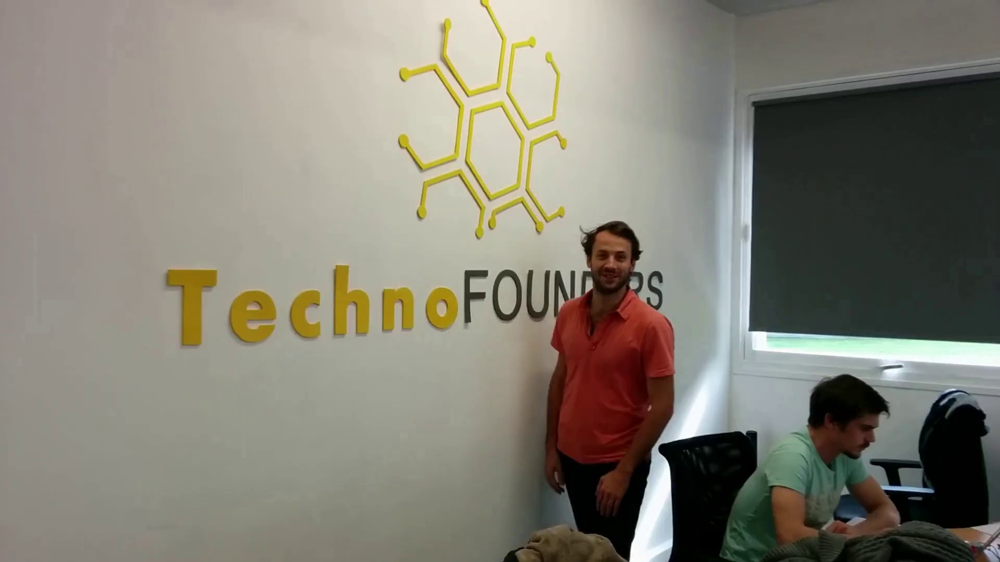

In [7]:
Image.fromarray(images['frame79.jpg'])

In [8]:
frame_images = list(images.values())

In [9]:
len(frame_images)

114

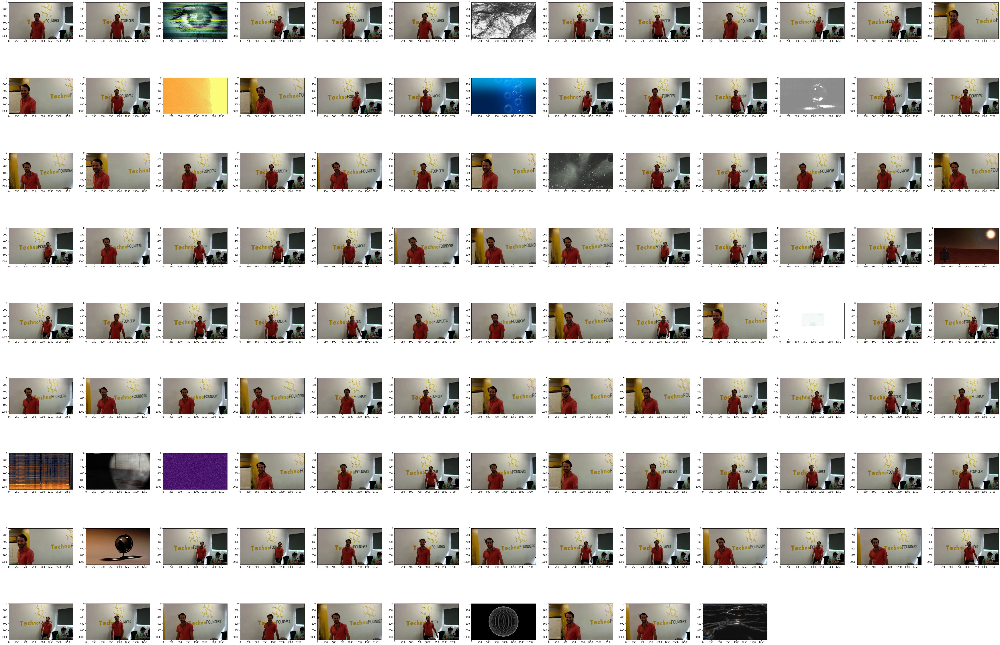

In [10]:
display_frames(frame_images)

In [11]:
def frame_sort_by_opencv(index,Reference:'frame79.jpg' ,metric_choice = cv2.HISTCMP_BHATTACHARYYA):
    results = {}
    for (idx, hist) in index.items():
        distance = cv2.compareHist(index[Reference], hist, metric_choice)
        results[idx] = distance
    results = sorted([(val, idx)for (idx, val) in results.items()])
    return results

In [12]:
corr_res = frame_sort_by_opencv(index, Reference= 'frame79.jpg',metric_choice= cv2.HISTCMP_CORREL)

In [13]:
corr_res.reverse()

In [14]:
corr_res

[(1.0, 'frame79.jpg'),
 (0.9999710890126918, 'frame1.jpg'),
 (0.9999059199929792, 'frame23.jpg'),
 (0.999821561558196, 'frame30.jpg'),
 (0.9997806877965979, 'frame93.jpg'),
 (0.9996682579751374, 'frame4.jpg'),
 (0.9995563612350444, 'frame66.jpg'),
 (0.9995203739617222, 'frame51.jpg'),
 (0.9992676991232335, 'frame52.jpg'),
 (0.9990824323425176, 'frame20.jpg'),
 (0.9990788715100601, 'frame54.jpg'),
 (0.9990360035664384, 'frame72.jpg'),
 (0.998796706853532, 'frame49.jpg'),
 (0.9987549045868395, 'frame59.jpg'),
 (0.9985895175704141, 'frame22.jpg'),
 (0.9980814822771965, 'frame32.jpg'),
 (0.9976945871292187, 'frame106.jpg'),
 (0.9975829047061481, 'frame64.jpg'),
 (0.9975348326128385, 'frame9.jpg'),
 (0.9972310587721154, 'frame104.jpg'),
 (0.9969274819852747, 'frame18.jpg'),
 (0.9968874197919582, 'frame15.jpg'),
 (0.9962586359036529, 'frame35.jpg'),
 (0.9961493041534434, 'frame61.jpg'),
 (0.9958466258268706, 'frame108.jpg'),
 (0.995611515386805, 'frame62.jpg'),
 (0.9954090451984438, 'frame3.

In [15]:
results = corr_res

In [16]:
def get_sorted_frames(images_idx, results):
    sorted_idx = []
    for result in results:
        sorted_idx.append(result[1])
    sorted_frame = []
    for idx in sorted_idx:
        sorted_frame.append(images_idx[idx])
    return sorted_frame 

In [17]:
sr_fr = get_sorted_frames(images, results)

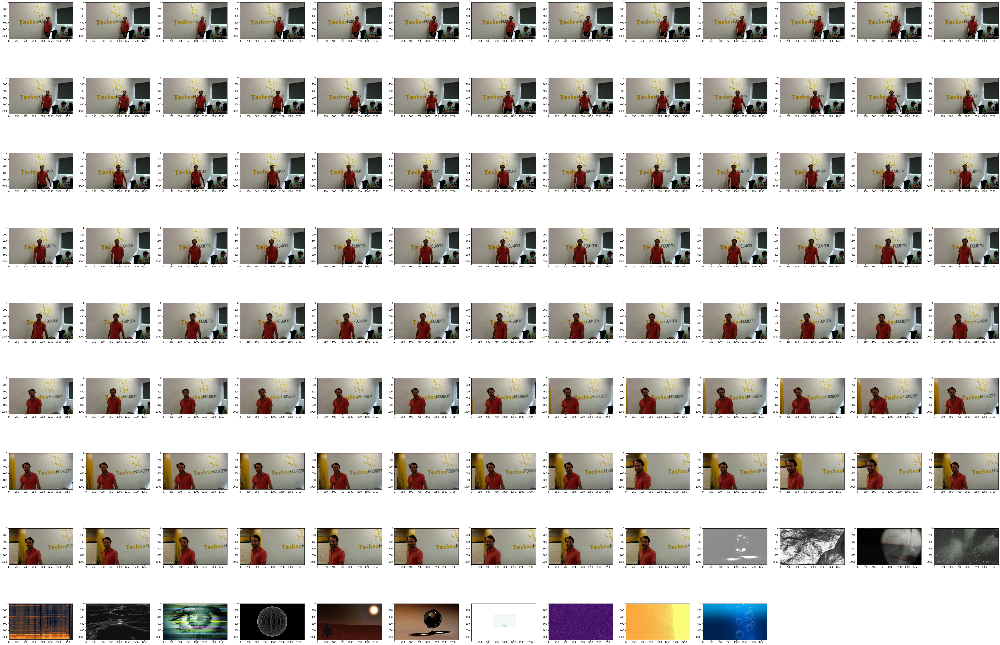

In [18]:
display_frames(sr_fr)

In [19]:
def get_vedio_from_frames(frame_list, file_name: str):
    height, width, layers = frame_list[0].shape
    size = (width,height)
    output = cv2.VideoWriter(file_name, cv2.VideoWriter_fourcc(*'DIVX'), 15, size)
    
    for i in range(len(frame_list)):
        output.write(frame_list[i])
    output.release()

In [ ]:
get_vedio_from_frames(sr_fr, file_name='first_reconstruction.mp4')

##### SCIPY_METRICS_FOR_FRAME_SIMILARITY

In [20]:
def frame_sorting_scipy(index, Reference:'frame79.jpg' ,metric_choice = dist.chebyshev):
    results = {}
    for (idx, hist) in index.items():
        distance = metric_choice(index["frame79.jpg"],hist)
        results[idx] = distance
    results = sorted([(val, idx)for (idx, val) in results.items()])
    return results

In [21]:
chebyshev_res = frame_sorting_scipy(index, Reference='frame79.jpg', metric_choice = dist.chebyshev)

In [22]:
chebyshev_res

[(0.0, 'frame79.jpg'),
 (0.0034671128, 'frame1.jpg'),
 (0.0071324483, 'frame23.jpg'),
 (0.01053901, 'frame4.jpg'),
 (0.011291295, 'frame30.jpg'),
 (0.0140551925, 'frame93.jpg'),
 (0.015385911, 'frame51.jpg'),
 (0.016627729, 'frame52.jpg'),
 (0.018401861, 'frame72.jpg'),
 (0.018850893, 'frame66.jpg'),
 (0.020020038, 'frame20.jpg'),
 (0.020132586, 'frame49.jpg'),
 (0.021525145, 'frame54.jpg'),
 (0.023417383, 'frame59.jpg'),
 (0.024723142, 'frame22.jpg'),
 (0.032209247, 'frame32.jpg'),
 (0.03852681, 'frame106.jpg'),
 (0.040417723, 'frame64.jpg'),
 (0.042913847, 'frame9.jpg'),
 (0.045061655, 'frame104.jpg'),
 (0.045332566, 'frame15.jpg'),
 (0.04663127, 'frame18.jpg'),
 (0.04680427, 'frame35.jpg'),
 (0.04767731, 'frame61.jpg'),
 (0.048957385, 'frame108.jpg'),
 (0.054688476, 'frame62.jpg'),
 (0.05780282, 'frame3.jpg'),
 (0.060478665, 'frame68.jpg'),
 (0.06365495, 'frame109.jpg'),
 (0.06646457, 'frame92.jpg'),
 (0.06953423, 'frame41.jpg'),
 (0.07112196, 'frame14.jpg'),
 (0.07132676, 'frame48.

In [24]:
chebyshev_result = chebyshev_res
scipy_chebyshev_sr_fr = get_sorted_frames(images, chebyshev_result)

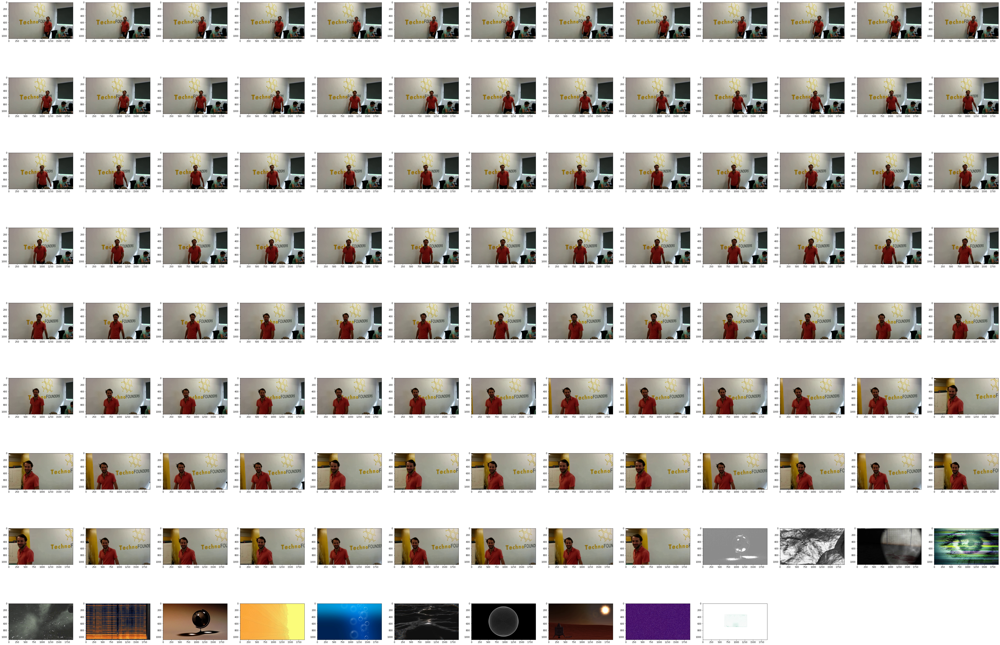

In [25]:
display_frames(scipy_chebyshev_sr_fr)

#### Outlier Elimanition using Consecutive ImageHash Difference

In [27]:
def eliminate_outlier_frame(image_idx, results, hash_threshold = 20):
    hash_difference = []
    result_frames = []
    for result in results:
        result_frames.append(image_idx[result[1]])
    
    for i in range(len(result_frames) - 1):
    
        hash_value = imagehash.average_hash(Image.fromarray(result_frames[i]))
        hash_value_next = imagehash.average_hash(Image.fromarray(result_frames[i+1]))
        hash_diff = hash_value - hash_value_next
        hash_difference.append(hash_diff)
        
    outlier_hashes = [idx for idx, _hash in enumerate(hash_difference) if _hash >= hash_threshold]
    clean_frames = result_frames[0:outlier_hashes[0]+1]
        
    return clean_frames   

In [28]:
test = eliminate_outlier_frame(images, chebyshev_result, hash_threshold = 20)

In [29]:
len(test)

100

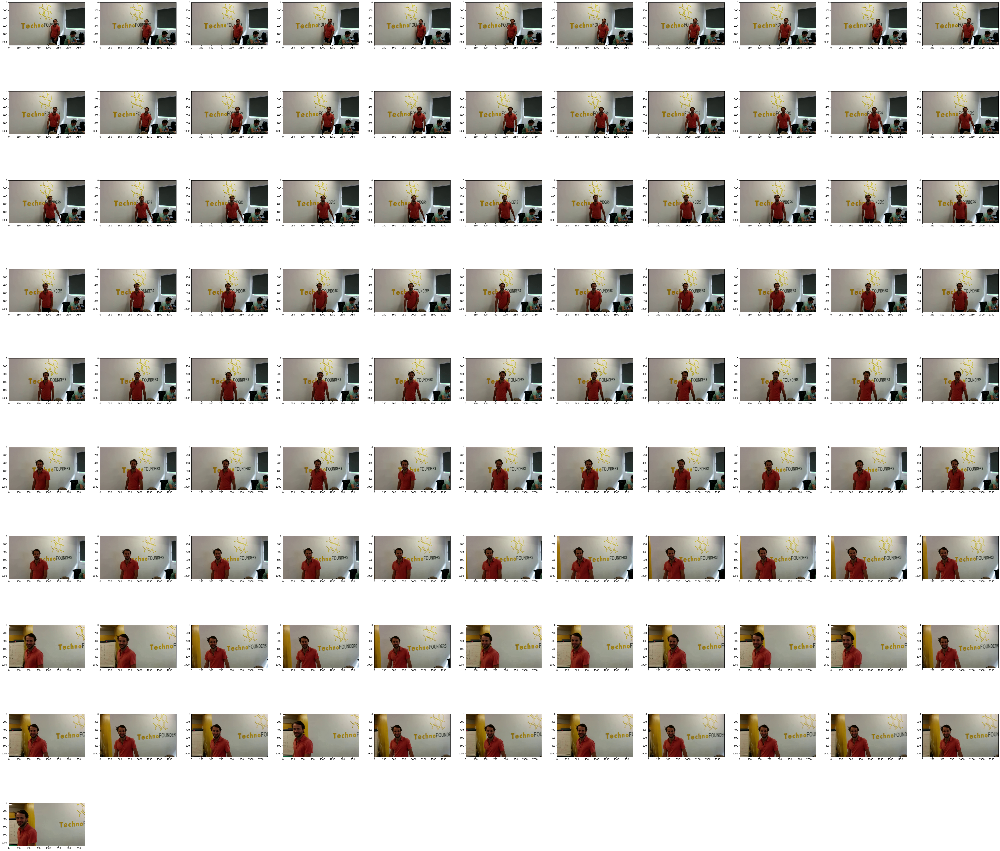

In [30]:
display_frames(test)